## Embedding cluster

In [1]:
import sys
import matplotlib.pyplot as plt
import numpy as np
import gc
from tqdm import tqdm
from pathlib import Path
from datasets import Dataset
# from sklearn.cluster import (
    # HDBSCAN, DBSCAN, AgglomerativeClustering)
from hdbscan import HDBSCAN

SRC_PATH = Path("../src").resolve()
sys.path.append(str(SRC_PATH))

from embedding.reduction import get_embeddings, pacmap_embeddings, umap_embeddings

In [2]:
RUN_PATH = Path("./run").resolve()
DATA_PATH = Path("../data/163/").resolve()
MODEL_NAME = "dangvantuan/sentence-camembert-large"
SAVE_PATH = Path("../data/embeddings").resolve()

In [3]:
if "dataset" not in [*locals(), *globals()]:
    dataset = Dataset.load_from_disk(SAVE_PATH)

/home/machine_learning/.anaconda3/envs/ia4gov/lib/python3.11/site-packages/datasets/table.py:1421: FutureWarning: promote has been superseded by mode='default'.
  table = cls._concat_blocks(blocks, axis=0)


In [4]:
arr = np.array(dataset["embeddings"])
print(f'{arr.shape=}')

arr.shape=(169133, 1024)


In [5]:
# calculate embeddings
# WARNING: pacmap crash with too much component
embeddings_ = umap_embeddings(arr, n_components=20, random_state=42, unique=True, verbose=True)
embeddings_2d = umap_embeddings(arr, n_components=2, random_state=42, unique=True, verbose=True)

/home/machine_learning/.anaconda3/envs/ia4gov/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


UMAP(angular_rp_forest=True, metric='cosine', n_components=20, random_state=42, unique=True, verbose=True)
Unique=True -> Number of data points reduced from  169133  to  123459
Most common duplicate is 30  with a count of  1910
Fri Dec  8 21:27:46 2023 Construct fuzzy simplicial set
Fri Dec  8 21:27:46 2023 Finding Nearest Neighbors
Fri Dec  8 21:27:46 2023 Building RP forest with 23 trees
Fri Dec  8 21:27:59 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	Stopping threshold met -- exiting after 5 iterations
Fri Dec  8 21:28:24 2023 Finished Nearest Neighbor Search
Fri Dec  8 21:28:28 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Dec  8 21:31:24 2023 Finished embedding


/home/machine_learning/.anaconda3/envs/ia4gov/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


UMAP(angular_rp_forest=True, metric='cosine', random_state=42, unique=True, verbose=True)
Unique=True -> Number of data points reduced from  169133  to  123459
Most common duplicate is 30  with a count of  1910
Fri Dec  8 21:31:36 2023 Construct fuzzy simplicial set
Fri Dec  8 21:31:36 2023 Finding Nearest Neighbors
Fri Dec  8 21:31:36 2023 Building RP forest with 23 trees
Fri Dec  8 21:31:43 2023 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	Stopping threshold met -- exiting after 5 iterations
Fri Dec  8 21:31:49 2023 Finished Nearest Neighbor Search
Fri Dec  8 21:31:50 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Dec  8 21:32:57 2023 Finished embedding


In [6]:
del arr  # to get space
gc.collect()

21183

In [16]:
# dataset = dataset.remove_columns('umap').add_column("umap", embeddings_.tolist())
# dataset = dataset.remove_columns('umap_2d').add_column("umap_2d", embeddings_2d.tolist())

/home/machine_learning/.anaconda3/envs/ia4gov/lib/python3.11/site-packages/datasets/table.py:1387: FutureWarning: promote has been superseded by mode='default'.
  return cls._concat_blocks(pa_tables_to_concat_vertically, axis=0)


In [8]:
# step = 20

clusterer = HDBSCAN(
    cluster_selection_epsilon=0.2,
    alpha=1.,
    min_samples=30,
    min_cluster_size=100,
    metric="euclidean",
)

clusterer.fit(embeddings_)
categories = clusterer.labels_
unique_categories = np.unique(categories)
print(unique_categories)

[ -1   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16
  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34
  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142
 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160
 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178
 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202]


In [11]:
dataset = dataset.remove_columns("cluster").add_column("cluster", categories)
dataset = dataset.remove_columns('umap').add_column("umap", embeddings_.tolist())
dataset = dataset.remove_columns('umap_2d').add_column("umap_2d", embeddings_2d.tolist())

/home/machine_learning/.anaconda3/envs/ia4gov/lib/python3.11/site-packages/datasets/table.py:1387: FutureWarning: promote has been superseded by mode='default'.
  return cls._concat_blocks(pa_tables_to_concat_vertically, axis=0)


In [13]:
# dataset.save_to_disk('../data/embeddings_2')

Saving the dataset (0/2 shards):   0%|          | 0/169133 [00:00<?, ? examples/s]

TODO:
1. get duplicate
2. remove duplicate
3. calculate UMAP embeddings / embeddings 2D
4. replot

In [14]:
import plotly.express as px

In [16]:
subdataset = dataset.filter(lambda cluster: cluster >= 0, input_columns="cluster")
embeddings_2d = np.array(subdataset["umap_2d"])
color = np.array(subdataset['cluster'])
hover_data = np.array(subdataset['text'])

In [23]:
len(hover_data)

135942

array([['cibler les classes moyennes supérieures',
        "cesser d'exonérer plus de 50% de la population",
        "baisser la 1ère tranche d'impot à 7%", ...,
        "facturer les personnes payant leurs impôts à l'étranger",
        'facturer les soins donnés en France',
        'reponse figurant a la question precedente']], dtype='<U822')

In [28]:
fig = px.scatter(
    x=embeddings_2d[:, 0],
    y=embeddings_2d[:, 1],
    color=color.astype(str),
    hover_data=hover_data.reshape(1, -1),
    color_discrete_sequence=px.colors.qualitative.Alphabet,
)
fig.show()

**Observation**
- plusieurs phrases similaires
- il n'est pas évident de connaitre les regroupements les plus volumineux.

**Proposal**
- définir une phrase résumé par groupe.
- créer un figure de bar horizontal (bar plot) avec les sujets les plus importants.

In [29]:
# mask = categories >= 0
# plt.scatter(*embeddings_2d[mask].T, s=2, c=categories[mask], cmap=plt.cm.tab20)
# plt.scatter(*embeddings_2d[~mask].T, s=2, c="grey", alpha=0.1)
# # plt.scatter(*np.array(dataset.select([idx_1, idx_2, idx_3])["umap_2d"]).T, s=100, c='red')
# plt.title('Idées principales projettées en 2D')
# plt.show()

In [30]:
# from pprint import pprint

# cluster_sizes = {}
# for i in sorted(np.unique(categories)):
#     if i>=0:
#         subdataset = dataset.filter(lambda x: x == i, input_columns="cluster")
#         cluster_sizes[i] = len(subdataset)
#         print(f"Cluster {i}, size:", len(subdataset))
#         pprint(subdataset[:10]["text"])
#         print("\n")

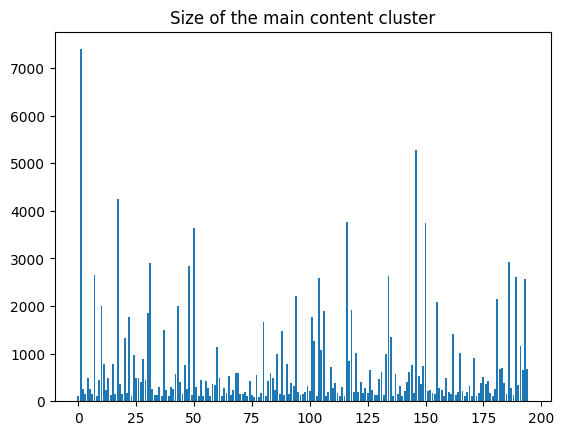

In [133]:
plt.bar(cluster_sizes.keys(), cluster_sizes.values())
plt.title('Size of the main content cluster')
plt.show()